# Урок 5
В этой демонстрации попрактикуемся в решении некоторых задач CV.

1. Задача семантической сегментации: построим сеть, обучим ее, замерим качество.
2. Генерация изображений: воспользуемся предобученной сетью GAN для генерации лиц и посмотрим на качество.

## Семантическая сегментация в PyTorch

Напомним постановку.
В задаче семантической сегментации мы хотим каждому пикселю изображения поставить в соответствие одну метку класса.

В качестве датасета возьмем NYUv2.

В качестве модели возьмем U-Net. Оптимизировать будем кросс-энтропию, усредненную по всем пикселям.

В качестве метрики качества возьмем IoU.

In [2]:
# Загрузка датасета
!wget http://horatio.cs.nyu.edu/mit/silberman/nyu_depth_v2/nyu_depth_v2_labeled.mat

In [ ]:
# Скачайте "labeled dataset" отсюда https://cs.nyu.edu/~fergus/datasets/nyu_depth_v2.html
# Прямая ссылка http://horatio.cs.nyu.edu/mit/silberman/nyu_depth_v2/nyu_depth_v2_labeled.mat

# Датасет в немного необычном формате, код ниже приводит его в тензоры
import h5py
import torch
import numpy as np
import matplotlib.pyplot as plt


def show_sample(img_np: np.ndarray, label_np: np.ndarray):
    _, ax = plt.subplots(1, 2, figsize=(16, 9))
    ax[0].imshow(img_np.transpose((1, 2, 0)))
    ax[1].imshow(label_np)
    plt.show()


# Считаем из HDF5 формата
# Подробнее про h5py: https://docs.h5py.org/en/stable/quick.html#quick
data = h5py.File("nyu_depth_v2_labeled.mat")
print(data.keys())
print()
print(data["labels"])
print()
print(data["images"])

# Преобразуем в numpy-массив
raw_images, raw_labels, names = data["images"], data["labels"], data["names"]

# сохраню дополнительно имена классов
class_names = []
for ref in names[0]:
    # Получаем объект по ссылке
    name_obj = data[ref]
    
    # Преобразуем в строку (данные хранятся как массив символов)
    name_str = ''.join(chr(c[0]) for c in name_obj[:])
    class_names.append(name_str)

del data
all_imgs_np, all_labels_np = np.empty_like(raw_images), np.empty_like(raw_labels)
raw_images.read_direct(all_imgs_np)
raw_labels.read_direct(all_labels_np)
del raw_images, raw_labels

# Покажем пример одной картинки
show_sample(all_imgs_np[10], all_labels_np[10])

In [29]:
# Вывод списка классов
print("Все классы в датасете:")
for i, name in enumerate(class_names):
    print(f"{i+1}: {name}")

In [4]:
# Какой размер датасета?
def print_size_mb(tensor: np.ndarray):
    print("Size in Mb:", tensor.itemsize * tensor.size >> 20)

print_size_mb(all_imgs_np)
print_size_mb(all_labels_np)

Будем разбивать на батчи.

In [36]:
seed = 0
batch_size = 4
n_steps_before_backward = 8
# С точки зрения оптимизации будет real_batch_size = batch_size * n_steps_before_backward

In [37]:
import os
import random


def enable_determinism():
    os.environ["CUBLAS_WORKSPACE_CONFIG"] = ":4096:8"
    torch.use_deterministic_algorithms(True)


def fix_seeds(seed: int):
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.mps.manual_seed(seed)


enable_determinism()
fix_seeds(0)

In [38]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torch.utils.data import Dataset


class SegmentationDataset(Dataset):
    def __init__(
        self, img_array: np.ndarray, label_array: np.ndarray, transforms: A.Compose
    ):
        label_array = label_array.astype("int32")
        self.img_array = img_array.transpose((0, 2, 3, 1))
        self.label_array = label_array
        self.transforms = transforms

    def __getitem__(self, index):
        transformed = self.transforms(
            image=self.img_array[index], mask=self.label_array[index]
        )
        return transformed["image"], transformed["mask"]

    def __len__(self):
        return len(self.img_array)


all_dataset = SegmentationDataset(
    all_imgs_np,
    all_labels_np,
    transforms=A.Compose([A.Resize(128, 128), A.ToFloat(max_value=255), ToTensorV2()]),
)

In [8]:
print(all_dataset[0][0].shape)
plt.imshow(all_dataset[0][0].permute((1, 2, 0)))
plt.show()
plt.imshow(all_dataset[0][1])

In [39]:
from torch.utils.data import DataLoader, random_split

generator = torch.Generator().manual_seed(seed)
train_dataset, val_dataset, test_dataset = random_split(
    all_dataset, [0.8, 0.1, 0.1], generator=generator
)
train_loader = DataLoader(
    train_dataset, batch_size=batch_size, shuffle=True, generator=generator
)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [57]:
from functools import reduce

import torch.nn as nn
import torch.nn.functional as F
import tqdm
import wandb
from torch.optim import Adam


def calc_accuracy(model: nn.Module, loader: DataLoader, device: torch.device):
    count_correct, count_total = 0, 0
    model.eval()
    for img_batch, true_labels in loader:
        img_batch = img_batch.to(device)
        true_labels = true_labels.to(device)
        with torch.no_grad():
            prediction = model(img_batch)
        # (B, K, H, W)
        # pred_labels = (prediction > 0).squeeze(1)
        pred_labels = torch.argmax(prediction, dim=1)
        count_correct += (pred_labels == true_labels).sum().item()
        # произведение всех размерностей
        count_total += reduce(lambda a, b: a * b, true_labels.shape, 1)
    model.train()
    return count_correct / count_total


def train_loop(
    model: nn.Module,
    train_loader: DataLoader,
    val_loader: DataLoader,
    device: torch.device,
):
    lr = 1e-3
    n_epochs = 3
    eval_every = 20
    optimizer = Adam(model.parameters(), lr=lr)
    model.to(device)
    criterion = nn.CrossEntropyLoss(reduction="none")

    for epoch in range(n_epochs):
        print(f"Epoch #{epoch + 1}/#{n_epochs}")
        for i, (img_batch, true_labels) in enumerate(tqdm.tqdm(train_loader)):
            step = epoch * len(train_loader) + i
            img_batch, true_labels = img_batch.to(device), true_labels.to(device)

            pred_labels = model(img_batch).squeeze()
            loss = criterion(pred_labels, true_labels.long()).mean()
            loss.backward()

            # Будем не каждую итерацию делать шаг спуска.
            # Это увеличит batch_size без необходимости вмещать больше в память.
            if (step + 1) % n_steps_before_backward == 0:
                optimizer.step()
                # optimizer.zero_grad()


            wandb.log({"loss": loss.cpu().item()}, step=step)
            if (i + 1) % eval_every == 0:
                wandb.log(
                    {"accuracy": calc_accuracy(model, val_loader, device)}, step=step
                )
        wandb.log({"accuracy": calc_accuracy(model, val_loader, device)}, step=step)

In [41]:
# Всего 895 классов
n_classes = len(class_names) + 1
n_classes

Будем использовать `ConvTranspose2d`. Как это работает:

![input](https://i.stack.imgur.com/wnE5e.png)

Ядро накладывается на каждый пиксель, потом результаты суммируются.
Как бы "свертка наоборот".

Случай `stride = 1, padding = 0`:

![input](https://i.stack.imgur.com/nQ9o7.png)

Детали [тут](https://stackoverflow.com/a/69785985/5183539), оттуда же взяты картинки.

In [42]:
# Бейзлайн: одна свертка, одна транспонированная свертка
class SimpleModel(nn.Module):
    def __init__(self, n_channels: int, n_classes: int, hidden_dim: int = 64):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(n_channels, hidden_dim, 3),
            nn.ConvTranspose2d(hidden_dim, n_classes, 3),
        )

    def forward(self, x):
        return self.net(x)


model = SimpleModel(n_channels=3, n_classes=n_classes)
model(next(iter(test_loader))[0]).shape

In [43]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# device = torch.device("cpu")

In [47]:
wandb.init(project="start-dl-lesson-5", name="simple-model-no_zero_grad")
train_loop(model, train_loader, val_loader, device=device)

### U-Net

Модель U-Net сначала превращает картинку в вектор с помощью сверток, потом из вектора обратно делает картинку с помощью usampling.
Архитектура модели приведена на картинке.

![U-Net](https://habrastorage.org/r/w1560/getpro/habr/upload_files/fc0/345/9ae/fc03459ae49b260a2f114d8cc338cc82.png)

Обратите внимание, выходы слоя слева передаются слою справа — тому, что стоит на том же уровне.

In [49]:
# Имплементация U-Net, взято из https://github.com/milesial/Pytorch-UNet
# Распространяется под лицензией GPL-3.0
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels, mid_channels=None):
        super().__init__()
        if not mid_channels:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        return self.double_conv(x)


class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2), DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

In [50]:
class Up(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()

        self.up = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)

    def forward(self, x: torch.Tensor, x_left: torch.Tensor):
        x = self.up(x)
        # Западдим картинку снизу, если размерности отличаются
        diffY = x_left.shape[2] - x.shape[2]
        diffX = x_left.shape[3] - x.shape[3]

        x = F.pad(x, [diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2])
        x = torch.cat([x_left, x], dim=1)
        return self.conv(x)


class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)


class UNet(nn.Module):
    def __init__(self, n_channels, n_classes):
        super(UNet, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes

        self.inc = DoubleConv(n_channels, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        factor = 2
        self.down4 = Down(512, 1024 // factor)
        self.up1 = Up(1024, 512 // factor)
        self.up2 = Up(512, 256 // factor)
        self.up3 = Up(256, 128 // factor)
        self.up4 = Up(128, 64)
        self.outc = OutConv(64, n_classes)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = self.outc(x)
        return logits

In [51]:
model = UNet(3, n_classes)
model(next(iter(test_loader))[0]).shape

In [52]:
torch.cuda.empty_cache()

In [58]:
wandb.init(project="start-dl-lesson-5", name="unet_no_zero_grad")
train_loop(model, train_loader, val_loader, device=device)

U-Net пробивает бейзлайн.

Давайте посмотрим, насколько хорошо U-Net размечает картинку.

In [54]:
@torch.inference_mode()
def visualize(model, batch, device):
    model.eval()
    xs, ys = batch
    for i, (x, y) in enumerate(zip(xs, ys)):
        prediction = model(x[None, ...].to(device)).cpu().squeeze(0).max(dim=0)[1]

        fig, ax = plt.subplots(1, 3, figsize=(24, 8), facecolor="white")

        ax[0].imshow(x.permute((1, 2, 0)))
        ax[1].imshow(y.to(torch.uint8))
        ax[2].imshow(prediction.to(torch.uint8))

        ax[0].axis("off")
        ax[1].axis("off")
        ax[2].axis("off")
        plt.subplots_adjust(wspace=0, hspace=0.1)
        plt.show()

        if i >= 9:
            break

In [55]:
visualize(model, next(iter(test_loader)), device=device)

### Резюме
1. Рассмотрели датасет NYUv2, обернули в Dataset и DataLoader.
2. Построили простую сеть, обучили — получили бейзлайн качества.
3. Взяли U-Net, обучили и улучшили метрику качества.

## Генерация лиц на примере DCGAN

_Вдохновлено этой [статьей](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)._

GAN — это архитектура, в которой две сети соревнуются друг с другом.
Одна сеть генерирует картинки, другая отличает настоящие картинки от сгенерированных.

Задача первой сети — выдать сгенерированное изображение за настоящее.
Задача второй сети — правильно отличить подделку от настоящей картинки.

Сформулируем задачу согласно пайплайну.

1. **Постановка задачи**. Хотим генерировать правдоподобные картинки лиц. Метрикой качества будет "на глаз".
2. **Подготовка данных**. Будем использовать датасет Celeba. Загрузите файл `img_align_celeba.zip` по [ссылке](https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg?resourcekey=0-rJlzl934LzC-Xp28GeIBzQ), распакуйте его (получится папка `img_align_celeba/`), затем положите в папку `data`. Получится `data/img_align_celeba/000001.jpg`.
3. **Выбор модели, функции потерь и оптимизатора**. Тут поинтереснее.

Модель возьмем следующую: несколько `Conv2dTranspose + BatchNorm + ReLU`, которые преобразуют вектор (100, ) в картинку (3, 64, 64).
Такую модель предложили в статье [DCGAN](https://arxiv.org/abs/1511.06434).

Насчет лосса: возьмем сумму ошибок генератора и дискриминатора.
Пусть $D(x)$ — выход дискриминатора, $G(z)$ — картинка, которую выдаст генератор, получивший на вход некий $z \sim p_z (z)$.
Тогда лосс будет:
$$
\min_G \max_D V(D, G) = \min_G \max_D \left[ \mathbb{E}_{x \sim p_{data} (x)} \ln D(x) + \mathbb{E}_{z \sim p_z (z)} \ln (1 - D(G(z))) \right]
$$

In [32]:
# Add input CelebFaces Jassica Li

dataroot = "/kaggle/input/datasets/jessicali9530/celeba-dataset/img_align_celeba/"
batch_size = 256
image_size = 64
nc = 3
# Размер латентного вектора - из него генератор будет создавать изображение
nz = 100
# Размер feature map в генераторе
ngf = 64
# Размер feature map в дискриминаторе
ndf = 64
num_epochs = 10
lr = 0.0002
beta1 = 0.5

/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


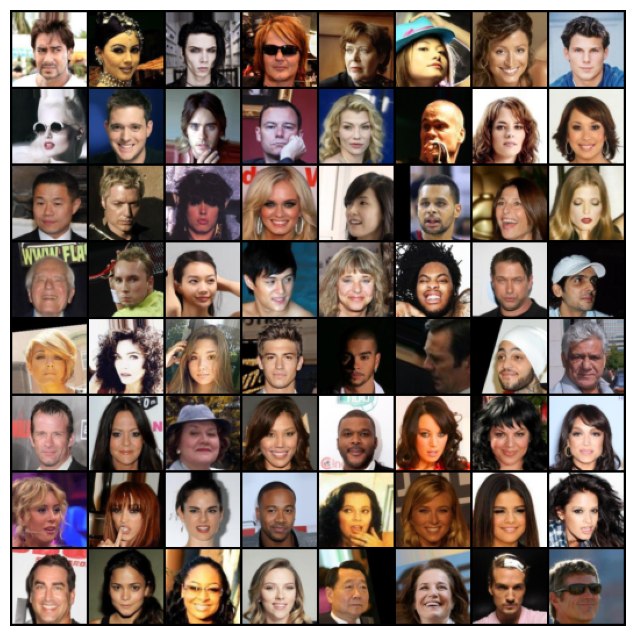

In [25]:
import torchvision.utils as vutils
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from torch.optim import Adam


generator = torch.Generator().manual_seed(0)

dataset = ImageFolder(
    root=dataroot,
    transform=transforms.Compose(
        [
            transforms.Resize(image_size),
            transforms.RandomHorizontalFlip(p=0.5),
            transforms.CenterCrop(image_size),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ]
    ),
)
dataloader = DataLoader(
    dataset, batch_size=batch_size, shuffle=True, generator=generator, num_workers=4
)

real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.imshow(
    np.transpose(
        vutils.make_grid(
            real_batch[0].to(device)[:64], padding=2, normalize=True
        ).cpu(),
        (1, 2, 0),
    )
)
plt.show()

In [27]:
# Инициализация весов
# Это советуют делать в оригинальной статье https://arxiv.org/abs/1511.06434
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm") != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [28]:
import torch.nn as nn

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh(),
            # (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

netG = Generator().to(device)
netG.apply(weights_init)
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [29]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid(),
        )

    def forward(self, input):
        return self.main(input)


netD = Discriminator().to(device)
netD.apply(weights_init)
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [30]:
from torch.optim import Adam

criterion = nn.BCELoss()

# Рисовать картинки будем из одного и того же шума, чтобы суметь сравнить разные итерации
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Метки для настоящего и фальшивого изображения
real_label, fake_label = 1., 0.

optimizerD = Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [33]:
img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        """
        Будет 2 шага:

        - показываем дискриминатору реальную картинку, посчитаем BCE против метки 1.
        - покажем дискриминатору фальшивую картинку, созданную геенератором, подсчитаем BCE против метки 0.
        - обновим веса дискриминатора

        - подсчитаем теперь для той же фальшивой картинки BCE против метки 1.
        - обновим веса генератора
        """               
        # Максимизируем по дискриминатору log(D(x)) + log(1 - D(G(z)))
        # Шаг по реальной картинке
        netD.zero_grad()
        real_batch = data[0].to(device)
        b_size = real_batch.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_batch).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # Шаг по фальшивой картинке
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        # .detach() "отключает" фейковые картинки от графа вычислений генератора, 
        # чтобы градиенты обновляли только дискриминатор.
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        # Максимизируем по генератору log(D(G(z)))
        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 50 == 0:
            print(
                "[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f"
                % (
                    epoch,
                    num_epochs,
                    i,
                    len(dataloader),
                    errD.item(),
                    errG.item(),
                    D_x,
                    D_G_z1,
                    D_G_z2,
                )
            )
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        if (iters % 500 == 0) or (
            (epoch == num_epochs - 1) and (i == len(dataloader) - 1)
        ):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        iters += 1

[0/10][0/792]	Loss_D: 0.3520	Loss_G: 4.0531	D(x): 0.8821	D(G(z)): 0.1716 / 0.0266
[0/10][50/792]	Loss_D: 0.4459	Loss_G: 2.8996	D(x): 0.7494	D(G(z)): 0.0956 / 0.0828
[0/10][100/792]	Loss_D: 0.4656	Loss_G: 2.7846	D(x): 0.7551	D(G(z)): 0.1103 / 0.0985
[0/10][150/792]	Loss_D: 2.2581	Loss_G: 8.0437	D(x): 0.9772	D(G(z)): 0.8164 / 0.0011
[0/10][200/792]	Loss_D: 0.4668	Loss_G: 3.8121	D(x): 0.8770	D(G(z)): 0.2487 / 0.0346
[0/10][250/792]	Loss_D: 0.3548	Loss_G: 3.5920	D(x): 0.8155	D(G(z)): 0.1033 / 0.0454
[0/10][300/792]	Loss_D: 0.3878	Loss_G: 3.4595	D(x): 0.8328	D(G(z)): 0.1502 / 0.0453
[0/10][350/792]	Loss_D: 1.9888	Loss_G: 2.1776	D(x): 0.2323	D(G(z)): 0.0026 / 0.1813
[0/10][400/792]	Loss_D: 1.7469	Loss_G: 2.3531	D(x): 0.2742	D(G(z)): 0.0009 / 0.1688
[0/10][450/792]	Loss_D: 0.5069	Loss_G: 4.5195	D(x): 0.8755	D(G(z)): 0.2698 / 0.0224
[0/10][500/792]	Loss_D: 0.4541	Loss_G: 3.0981	D(x): 0.8328	D(G(z)): 0.1933 / 0.0661
[0/10][550/792]	Loss_D: 0.6108	Loss_G: 2.9285	D(x): 0.7402	D(G(z)): 0.2052 / 0.

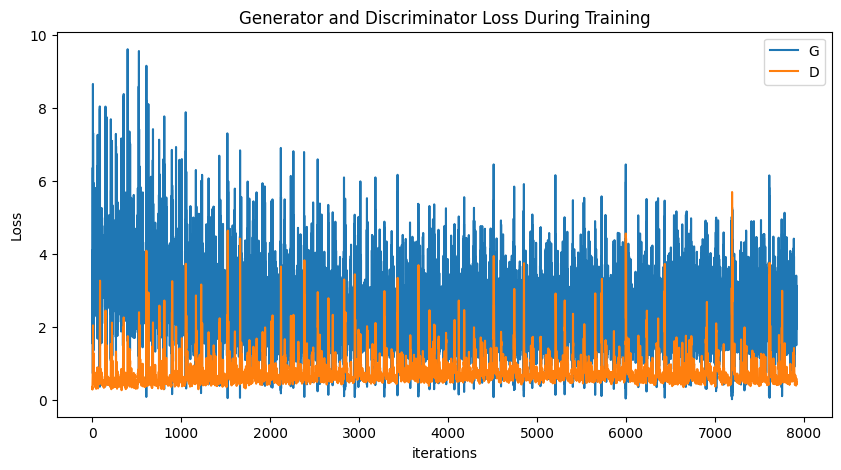

In [34]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

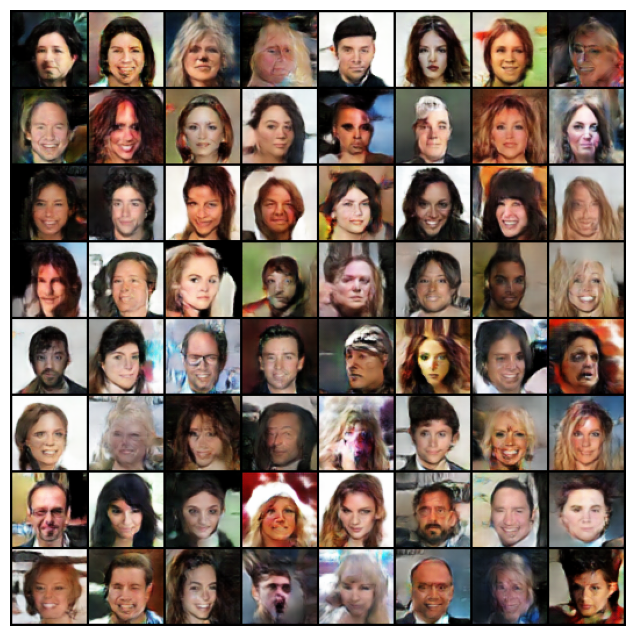

In [35]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


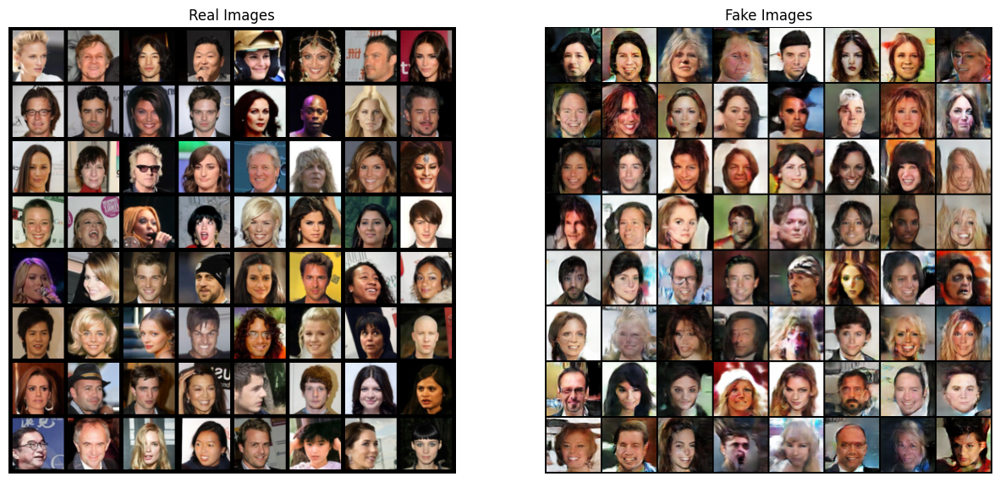

In [36]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

### Вывод
Простая архитектура DCGAN способна решать задачу генерации лиц, хотя качество не самое лучшее.

На DCGAN мир не остановился — вышло много улучшений.
Одна из недавних работ — [StyleGanV2](https://github.com/NVlabs/stylegan2-ada-pytorch).

## Резюме
1. Разобрали структуру U-Net.
2. Посмотрели, как решать задачу семантической сегментации с помощью U-Net.
3. Разобрали процесс обучения GAN.
3. Обучили DCGAN для генерации лиц, получили неплохое качество.